In [58]:
import os
#os.environ["CUDA_VISIBLE_DEVICES"] = "-1" # do not use GPU
%env SM_FRAMEWORK=tf.keras
from bfseg.data.meshdist.dataLoader import DataLoader
from bfseg.utils.losses import ignorant_cross_entropy_loss, ignorant_balanced_cross_entropy_loss
from bfseg.utils.metrics import IgnorantAccuracyMetric, IgnorantBalancedAccuracyMetric, IgnorantBalancedMeanIoU
from bfseg.utils.evaluation import scoreAndPlotPredictions
import segmentation_models as sm
import tensorflow as tf
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = [60, 40]
workingdir = "/home/rene/vicon_dataset/rotated/"
validationDir ='/home/rene/hiveLabels/'
# Desired image shape. Input images will be cropped + scaled to this shape
image_w = 480
image_h = 480
dataLoaderArche = DataLoader("/home/rene/cla_dataset/watershed/", [image_h, image_w],  validationDir = validationDir, validationMode="ARCHE", batchSize=5)
dataLoaderCLA = DataLoader(workingdir, [image_h, image_w],  validationDir = validationDir, validationMode="CLA", batchSize=5)

env: SM_FRAMEWORK=tf.keras
[WARNING] DID NOT FIND ANY DEPTH IMAGES!


In [2]:
def depth_loss_function(y_true, y_pred, theta=0.1, maxDepthVal=1000.0 / 10.0):
    # https://github.com/ialhashim/DenseDepth/blob/master/loss.py
    # Point-wise depth
    l_depth =  tf.keras.backend.mean( tf.keras.backend.abs(y_pred - y_true), axis=-1)

    # Edges
    dy_true, dx_true = tf.image.image_gradients(y_true)
    dy_pred, dx_pred = tf.image.image_gradients(y_pred)
    l_edges =  tf.keras.backend.mean( tf.keras.backend.abs(dy_pred - dy_true) +  tf.keras.backend.abs(dx_pred - dx_true), axis=-1)

    # Structural similarity (SSIM) index
    l_ssim =  tf.keras.backend.clip((1 - tf.image.ssim(y_true, y_pred, maxDepthVal)) * 0.5, 0, 1)

    # Weights
    w1 = 1.0
    w2 = 1.0
    w3 = theta

    return (w1 * l_ssim) + (w2 *  tf.keras.backend.mean(l_edges)) + (w3 *  tf.keras.backend.mean(l_depth))

In [3]:
def m_d_loss(y_true, y_pred):
    depth_label = y_true
    #tf.print(y_pred)
    y_pred_depth = y_pred
    y_pred_depth_ignorant = tf.where(tf.math.is_nan(depth_label), tf.zeros_like(depth_label), y_pred_depth)
    depth_label = tf.where(tf.math.is_nan(depth_label), tf.zeros_like(depth_label), depth_label)
    return tf.keras.losses.mean_absolute_error(depth_label,y_pred_depth_ignorant)#tf.keras.losses.ber(depth_label, y_pred_depth_ignorant)

In [20]:
def l(y_true, y_pred):
    print(y_true)
    print(y_pred)
    return 0

In [4]:
from bfseg.utils.metrics import IgnorantAccuracyMetric

In [40]:
train_ds, tst_cla = dataLoaderCLA.getDataset()

Tensor("Mul:0", shape=(480, 480, 1), dtype=int32)


In [30]:
train_ds_a, test_ds = dataLoaderArche.getDataset()

Tensor("Mul:0", shape=(480, 480, 1), dtype=int32)


In [6]:
from bfseg.models import MultiTaskingModels as mtm

In [7]:
model = mtm.PSPNet("resnet34", input_shape = (480, 480, 3), classes = 2)

In [7]:
model = mtm.Deeplabv3(input_shape = (480,480,3), classes = 2, activation = "sigmoid", OS = 16)

removing top for multitasking


In [32]:
for img, l in train_ds_a.take((1)):
    break

In [37]:
from bfseg.utils.evaluation import scoreAndPlotPredictions

In [ ]:

def scoreAndPlotPredictions(imageCallback, test_ds, num_images, plot=True):

Tensor("Mul:0", shape=(480, 480, 1), dtype=int32)


Tensor("Mul:0", shape=(480, 480, 1), dtype=int32)
Accuracy on validation set: 0.711666
mIoU on validation set: 0.47455573
Balanced mIoU on validation set: 0.42522085
Balanced Accuracy on validation set: 0.6247333
Positive = Foreground, Negative = Background
TPR on validation set: 0.9356455
TNR on validation set: 0.30420277
Precision  on validation set: 0.70983326


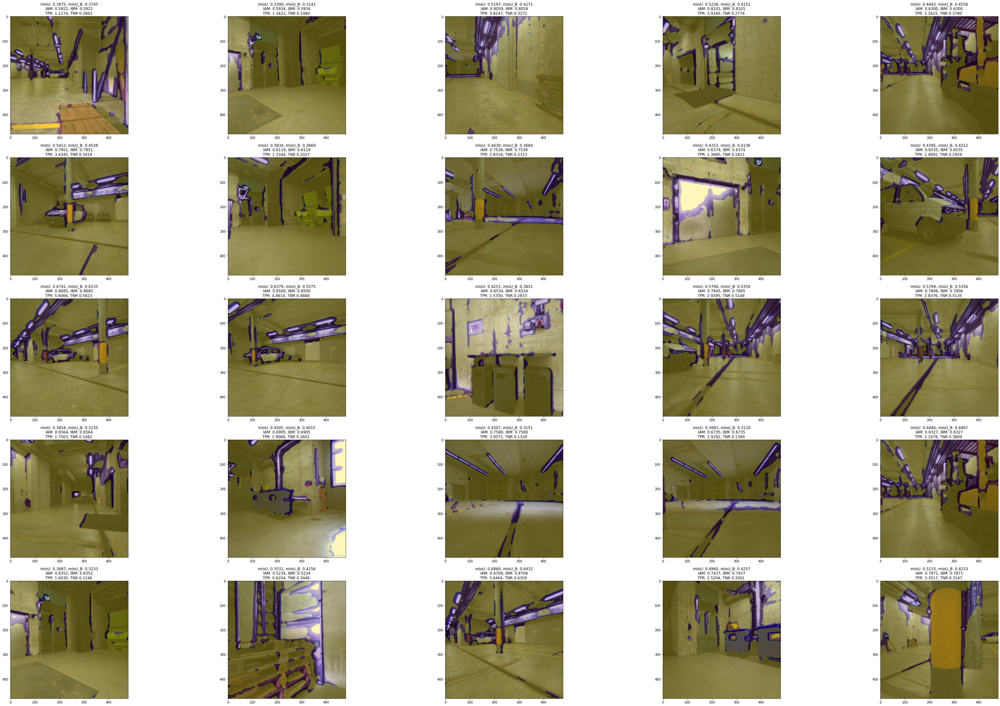

In [59]:
train_ds, tst_cla = dataLoaderCLA.getDataset()
scoreAndPlotPredictions(lambda img: model.predict(img)[1],
                        tst_cla,
                        dataLoaderCLA.validationSize,
                        plot=True)


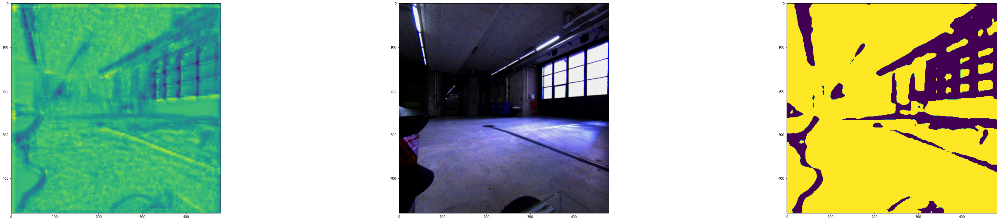

In [36]:
plt.subplot(3,3,1)
plt.imshow(model.predict(img)[0][0])
plt.subplot(3,3,2)
plt.imshow(img[0])
plt.subplot(3,3,3)
plt.imshow(tf.argmax(model.predict(img)[1], axis = -1)[0])

In [25]:
model.compile(optimizer='adam', loss = {'depth': m_d_loss, 'semseg':ignorant_balanced_cross_entropy_loss}, metrics={'semseg': [IgnorantAccuracyMetric(), IgnorantBalancedAccuracyMetric()]})

In [26]:
model.fit(train_ds, epochs = 1)

69/69 [==============================] - 34s 490ms/step - loss: 1.2882 - depth_loss: 0.3552 - semseg_loss: 0.9330 - semseg_ignorant_accuracy_metric: 0.8372 - semseg_ignorant_balanced_accuracy_metric: 0.8472


In [62]:
for img, l in train_ds.take((1)):
    break

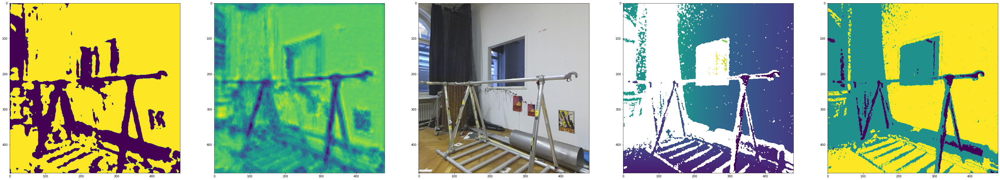

In [63]:
plt.subplot(1,5,1)
plt.imshow(tf.argmax(model.predict(img)[1],axis = -1)[0])
plt.subplot(1,5,2)
plt.imshow(model.predict(img)[0][0])
plt.subplot(1,5,3)
plt.imshow(img[0])
plt.subplot(1,5,4)
plt.imshow(l['depth'][0])
plt.subplot(1,5,5)
plt.imshow(l['semseg'][0])

In [58]:
m = IgnorantBalancedAccuracyMetric()
m.update_state( l['semseg'],model(img)[1])
m.result()

<tf.Tensor: shape=(), dtype=float32, numpy=0.9571692>

In [59]:
m = IgnorantBalancedMeanIoU()
m.update_state( l['semseg'],model(img)[1])
m.result()

<tf.Tensor: shape=(), dtype=float32, numpy=0.91780305>

In [13]:
ignorant_balanced_cross_entropy_loss( l['semseg'],model(img)[1])

<tf.Tensor: shape=(), dtype=float32, numpy=4.782767>

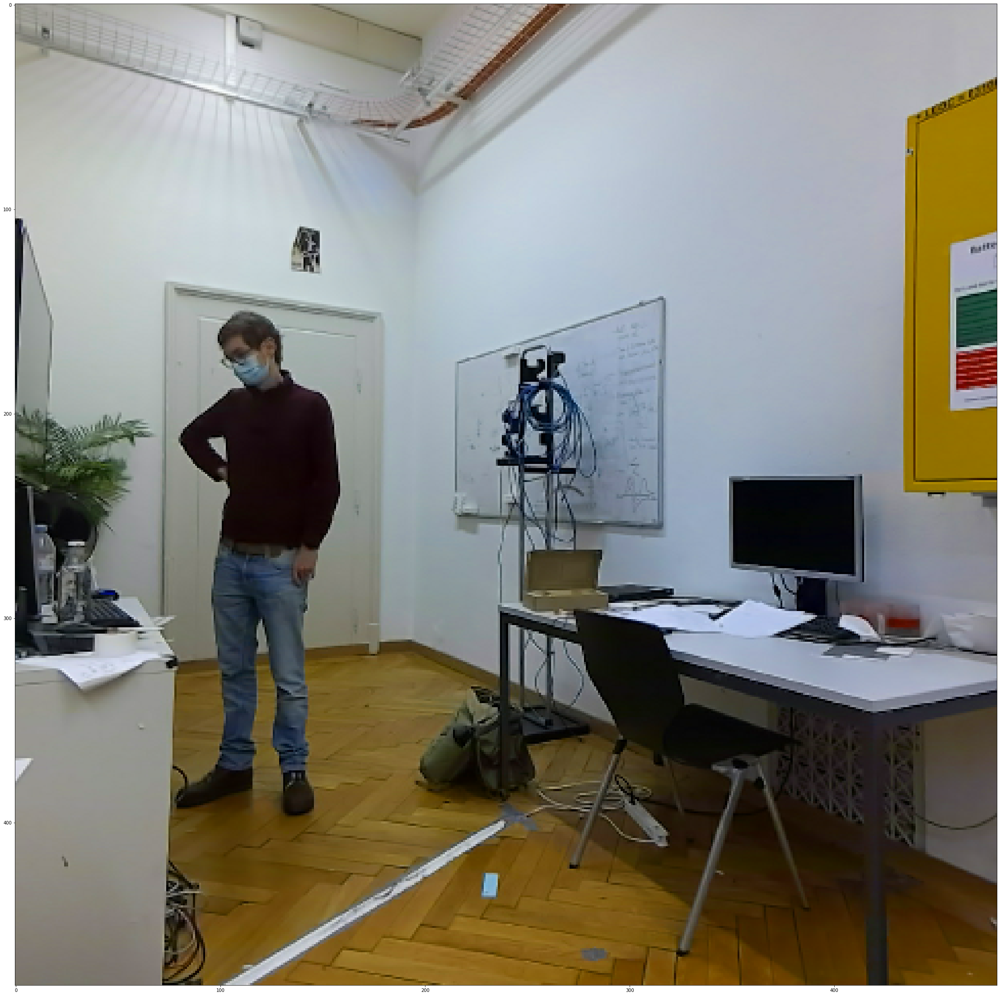

In [55]:
plt.imshow(img[0])

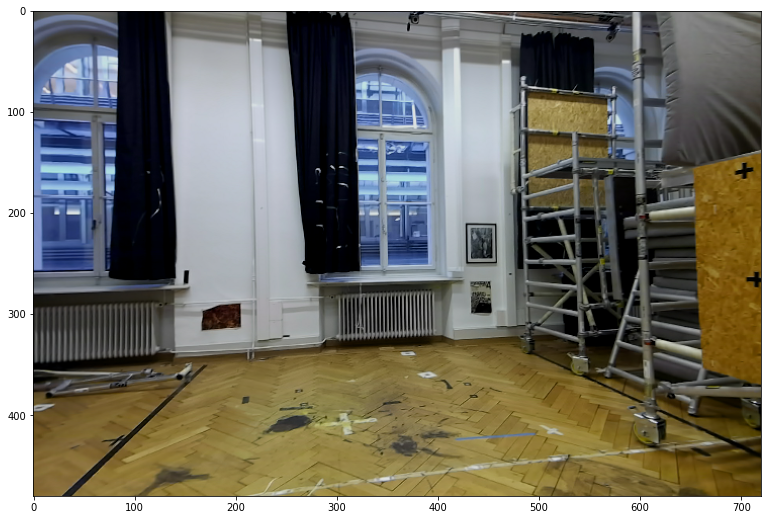

In [6]:
plt.subplot(3,4,1)
plt.imshow(img[0])
plt.subplot(3,4,2)
plt.imshow(img[0])

# Density Model

In [10]:
net = tf.saved_model.load('/home/rene/Downloads/nyu_density_module')

Accuracy on validation set: 0.5013192
mIoU on validation set: 0.3267347
Balanced mIoU on validation set: 0.36239517
Balanced Accuracy on validation set: 0.534169
Positive = Foreground, Negative = Background
TPR on validation set: 0.556584
TNR on validation set: 0.42012522
Precision  on validation set: 0.58509177


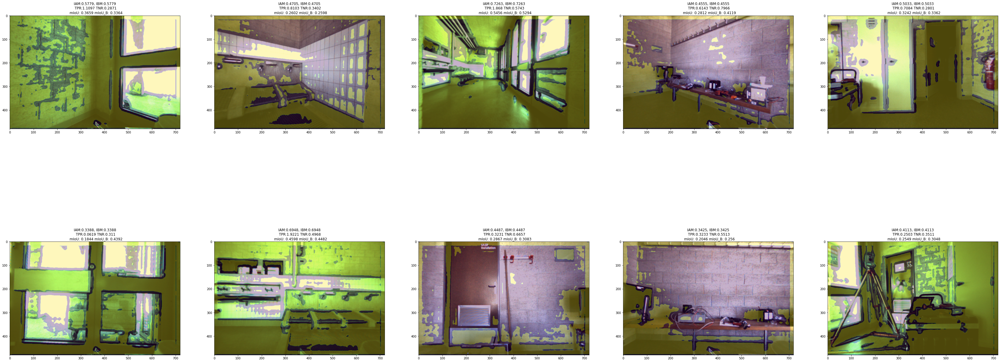

In [11]:
scoreAndPlotPredictions(lambda img:tf.keras.utils.to_categorical(tf.cast(net.signatures['serving_default'](img)['min_nll'] > 150, tf.int32), num_classes=2, dtype='float32' ), dataLoaderArche)

Accuracy on validation set: 0.62591493
mIoU on validation set: 0.42411315
Balanced mIoU on validation set: 0.40941328
Balanced Accuracy on validation set: 0.5878334
Positive = Foreground, Negative = Background
TPR on validation set: 0.73882264
TNR on validation set: 0.42455095
Precision  on validation set: 0.6960272


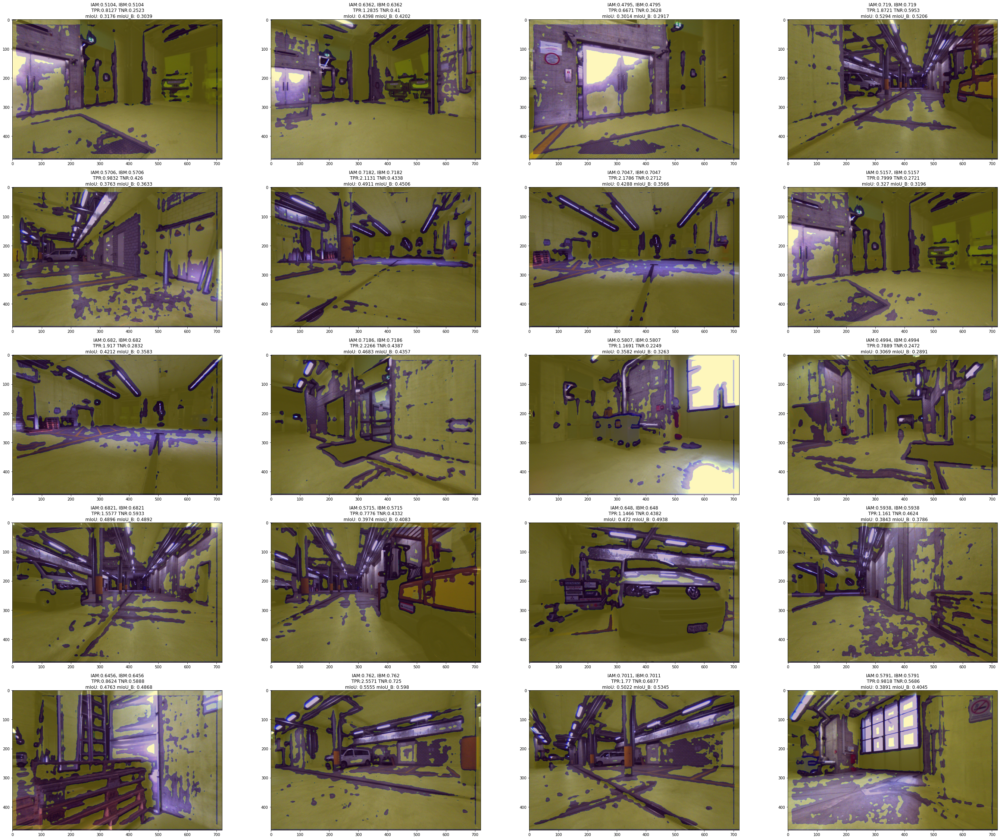

In [12]:
scoreAndPlotPredictions(lambda img:tf.keras.utils.to_categorical(tf.cast(net.signatures['serving_default'](img)['min_nll'] > 150, tf.int32), num_classes=2, dtype='float32' ), dataLoaderCLA)

# NYU Model Pretrained 30 Epochs

In [6]:
## Pretrained NYU model for 10 epochs

model_weights = '../src/baseline_model.h5'
BACKBONE = "vgg16"
model = sm.PSPNet(BACKBONE, input_shape=(image_h, image_w, 3), classes=2)

model.compile(
    loss=ignorant_cross_entropy_loss,
    optimizer=tf.keras.optimizers.Adam(0.001),
    metrics=['accuracy']
)

model.load_weights(model_weights)

/home/rene/catkin_ws/src/background_foreground_segmentation/src/bfseg/utils/evaluation.py:61: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  plt.subplot(batches, 5, i + cnt * batches + 1)


Accuracy on validation set: 0.48939067
mIoU on validation set: 0.3103075
Balanced mIoU on validation set: 0.3334756
Balanced Accuracy on validation set: 0.5337088
Positive = Foreground, Negative = Background
TPR on validation set: 0.2389774
TNR on validation set: 0.83392954
Precision  on validation set: 0.6644193


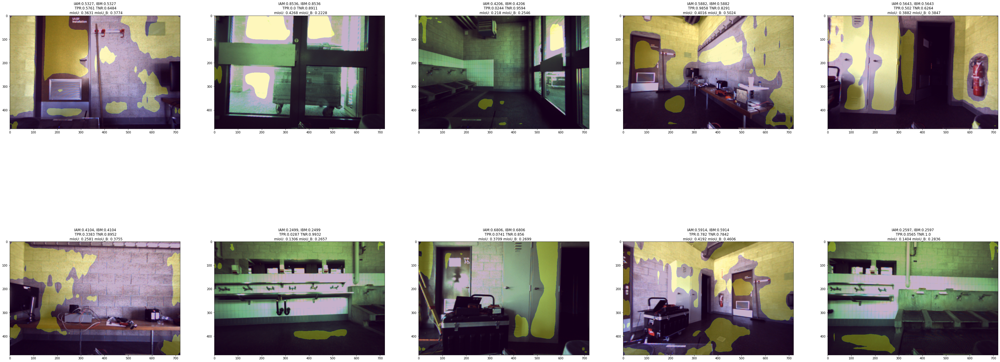

In [7]:
scoreAndPlotPredictions(lambda img: model.predict(img), dataLoaderArche) 

Accuracy on validation set: 0.8004006
mIoU on validation set: 0.6502373
Balanced mIoU on validation set: 0.6571178
Balanced Accuracy on validation set: 0.7931594
Positive = Foreground, Negative = Background
TPR on validation set: 0.81768143
TNR on validation set: 0.7681542
Precision  on validation set: 0.8680941


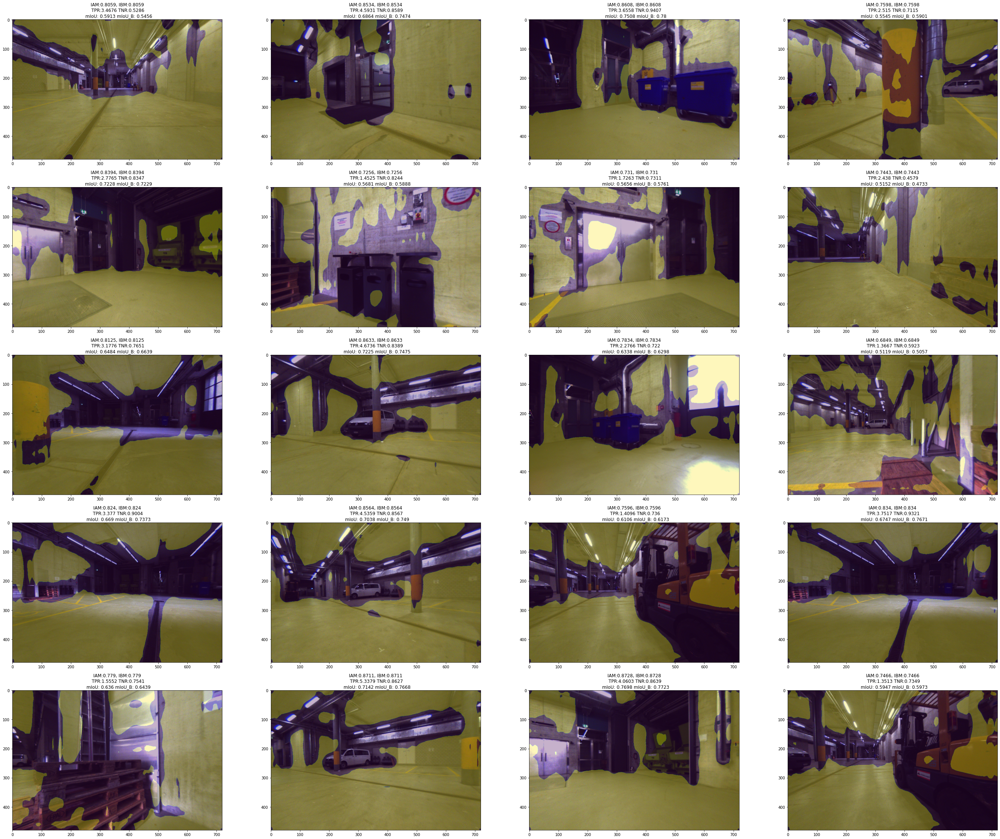

In [9]:
scoreAndPlotPredictions(lambda img: model.predict(img), dataLoaderCLA)